<a href="https://colab.research.google.com/github/kdemertzis/LNexamples/blob/main/Hojjat_Explanations.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install dalex
!pip install shap
!pip install -U statsmodels
!pip install lime

     |████████████████████████████████| 1.0 MB 5.3 MB/s 
     |████████████████████████████████| 26.5 MB 74.9 MB/s 
     |████████████████████████████████| 38.1 MB 1.1 MB/s 
  Created wheel for dalex: filename=dalex-1.4.1-py3-none-any.whl size=1042860 sha256=d8035e84e6f0033d4da0300e41c7486b82d0824ecbee834efbf04d65e7a22970
  Stored in directory: /root/.cache/pip/wheels/8c/8e/1b/95d59374d386e8e495aed6cbab4c4b6d72be73993a424c5e12
Successfully built dalex
  Attempting uninstall: scipy
    Found existing installation: scipy 1.4.1
    Uninstalling scipy-1.4.1:
      Successfully uninstalled scipy-1.4.1
  Attempting uninstall: plotly
    Found existing installation: plotly 4.4.1
    Uninstalling plotly-4.4.1:
      Successfully uninstalled plotly-4.4.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have img

In [3]:
import dalex as dx 

import numpy as np
import pandas as pd
import statsmodels
from sklearn.neural_network import MLPClassifier
from lightgbm import LGBMClassifier
#rom sklearn import svm
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
import warnings
warnings.filterwarnings('ignore')

In [4]:
data = pd.read_csv('/content/DDos.csv')

In [5]:
data.head()

,DestinationPort,FlowDuration,TotalFwdPackets,TotalBackwardPackets,TotalLengthofFwdPackets,TotalLengthofBwdPackets,FwdPacketLengthMax,FwdPacketLengthMin,FwdPacketLengthMean,FwdPacketLengthStd,BwdPacketLengthMax,BwdPacketLengthMin,BwdPacketLengthMean,BwdPacketLengthStd,FlowIATMean,FlowIATStd,FlowIATMax,FlowIATMin,FwdIATTotal,FwdIATMean,FwdIATStd,FwdIATMax,FwdIATMin,BwdIATTotal,BwdIATMean,BwdIATStd,BwdIATMax,BwdIATMin,FwdPSHFlags_binarized,FwdHeaderLength1,BwdHeaderLength,FwdPackets/s,BwdPackets/s,MinPacketLength,MaxPacketLength,PacketLengthMean,PacketLengthStd,PacketLengthVariance,FINFlagCount_binarized,SYNFlagCount_binarized,RSTFlagCount_binarized,PSHFlagCount_binarized,ACKFlagCount_binarized,URGFlagCount_binarized,ECEFlagCount_binarized,Down/UpRatio,AveragePacketSize,AvgFwdSegmentSize,AvgBwdSegmentSize,FwdHeaderLength,SubflowFwdPackets,SubflowFwdBytes,SubflowBwdPackets,SubflowBwdBytes,Init_Win_bytes_forward,Init_Win_bytes_backward,act_data_pkt_fwd,min_seg_size_forward,ActiveMean,ActiveStd,ActiveMax,ActiveMin,IdleMean,IdleStd,IdleMax,IdleMin,Label
0,0.837225,0.000000,0.000518,0.00000,0.000066,0.000000,0.000514,0.004076,0.001552,0.0,0.000000,0.00000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.001015,0.00000,0.222222,0.000000,0.017804,0.000514,0.003098,0.0,0.0,0,0,0,0,1,0,0,0.000000,0.00356,0.001552,0.000000,0.001015,0.000518,0.000066,0.00000,0.000000,0.000519,0.000000,0.000518,0.384615,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
1,0.840109,0.000001,0.000000,0.00034,0.000033,0.000001,0.000514,0.004076,0.001552,0.0,0.000514,0.00411,0.001551,0.0,0.000001,0.0,0.000001,0.000001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.000508,0.00034,0.003058,0.004587,0.017804,0.000514,0.003098,0.0,0.0,0,0,0,0,1,1,0,0.142857,0.00356,0.001552,0.001551,0.000508,0.000000,0.000033,0.00034,0.000001,0.000458,0.003922,0.000000,0.384615,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
2,0.840124,0.000000,0.000000,0.00034,0.000033,0.000001,0.000514,0.004076,0.001552,0.0,0.000514,0.00411,0.001551,0.0,0.000000,0.0,0.000000,0.000001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.000508,0.00034,0.006410,0.009615,0.017804,0.000514,0.003098,0.0,0.0,0,0,0,0,1,1,0,0.142857,0.00356,0.001552,0.001551,0.000508,0.000000,0.000033,0.00034,0.000001,0.000458,0.003922,0.000000,0.384615,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
3,0.705548,0.000000,0.000000,0.00034,0.000033,0.000001,0.000514,0.004076,0.001552,0.0,0.000514,0.00411,0.001551,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.000508,0.00034,0.009804,0.014706,0.017804,0.000514,0.003098,0.0,0.0,0,0,0,0,1,1,0,0.142857,0.00356,0.001552,0.001551,0.000508,0.000000,0.000033,0.00034,0.000001,0.000488,0.005035,0.000000,0.384615,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
4,0.837194,0.000000,0.000518,0.00000,0.000066,0.000000,0.000514,0.004076,0.001552,0.0,0.000000,0.00000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.001015,0.00000,0.222222,0.000000,0.017804,0.000514,0.003098,0.0,0.0,0,0,0,0,1,0,0,0.000000,0.00356,0.001552,0.000000,0.001015,0.000518,0.000066,0.00000,0.000000,0.000504,0.000000,0.000518,0.384615,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0


In [6]:
X = data.drop('Label', axis=1)


In [7]:
y = data.loc[:, ['Label']]

In [8]:
model_gbm = LGBMClassifier(n_estimators=200, max_depth=10, learning_rate=0.15, random_state=0)
model_gbm.fit(X, y)

LGBMClassifier(learning_rate=0.15, max_depth=10, n_estimators=200,
               random_state=0)

In [9]:
model_mlp = MLPClassifier(hidden_layer_sizes=(8,6,1), max_iter=300,activation = 'tanh',solver='adam',random_state=123)
model_mlp.fit(X, y)

MLPClassifier(activation='tanh', hidden_layer_sizes=(8, 6, 1), max_iter=300,
              random_state=123)

In [10]:
def predict_function(model, data):
    return np.exp(model.predict(data))

In [12]:
exp_mlp = dx.Explainer(model_mlp, data=X, y=y,  predict_function=predict_function, label='mlp')
exp_gbm = dx.Explainer(model_gbm, data=X, y=y, predict_function=predict_function, label='gbm')

Preparation of a new explainer is initiated

  -> data              : 171034 rows 66 cols
  -> target variable   : Parameter 'y' was a pandas.DataFrame. Converted to a numpy.ndarray.
  -> target variable   : 171034 values
  -> model_class       : sklearn.neural_network._multilayer_perceptron.MLPClassifier (default)
  -> label             : mlp
  -> predict function  : <function predict_function at 0x7fc08c0ab680> will be used
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 1.0, mean = 1.74, max = 2.72
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -2.72, mean = -1.3, max = 0.0
  -> model_info        : package sklearn

A new explainer has been created!
Preparation of a new explainer is initiated

  -> data              : 171034 rows 66 cols
  -> target variable   : Parameter 'y' was a pandas.DataFrame. Converted to a numpy.nd

In [14]:
pd.concat((exp_mlp.model_performance().result, exp_gbm.model_performance().result))

,recall,precision,f1,accuracy,auc
mlp,1.0,0.432949,0.604277,0.432949,0.968253
gbm,1.0,0.432949,0.604277,0.432949,0.969451


In [16]:
pp = exp_gbm.predict_parts(X.iloc[[1]], type='shap_wrapper', shap_explainer_type="TreeExplainer")
type(pp)

dalex.wrappers._shap.object.ShapWrapper

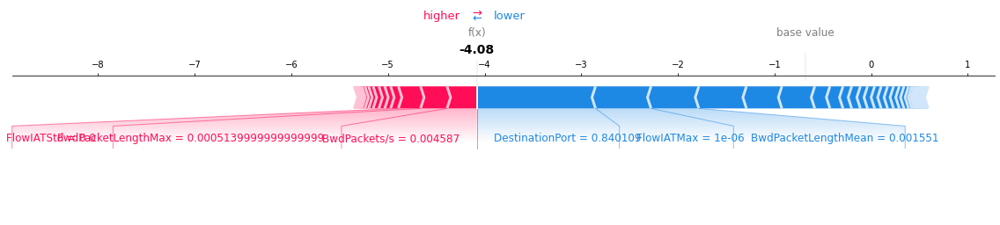

In [13]:
pp.plot()

In [17]:
pp.result 

array([[-1.22739825e+00,  7.95909707e-02,  1.89646066e-03,
        -5.87015348e-02, -1.35379624e-01, -1.90929474e-02,
         2.74098686e-01, -7.87671418e-03,  4.67254248e-02,
        -6.22642116e-02, -1.74056826e-02, -7.38630261e-02,
        -4.94538277e-01, -3.40248222e-01, -1.53895853e-02,
         2.29763954e-01, -5.74621621e-01,  5.99565646e-02,
        -2.11747470e-02,  6.89205783e-05, -1.56889891e-01,
         1.14859647e-02, -4.73894789e-02, -4.05005703e-03,
        -9.55499160e-03,  3.79131273e-02, -8.25105252e-03,
         6.53137922e-03,  0.00000000e+00,  1.24967320e-02,
        -2.63361437e-02, -3.66841772e-01,  3.08423905e-01,
        -8.19398483e-03,  6.34047061e-03, -3.29737599e-02,
        -7.36768240e-02,  2.41024678e-02,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        -1.47981286e-02, -6.56405474e-03,  0.00000000e+00,
         6.34984672e-04,  3.33582130e-02,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+0

In [18]:
mp = exp_gbm.model_parts(type='shap_wrapper', shap_explainer_type="TreeExplainer")
type(mp)

dalex.wrappers._shap.object.ShapWrapper

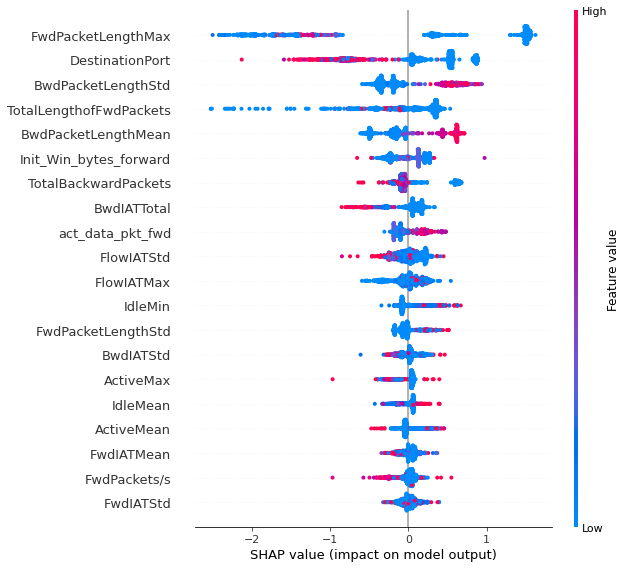

In [19]:
mp.plot()

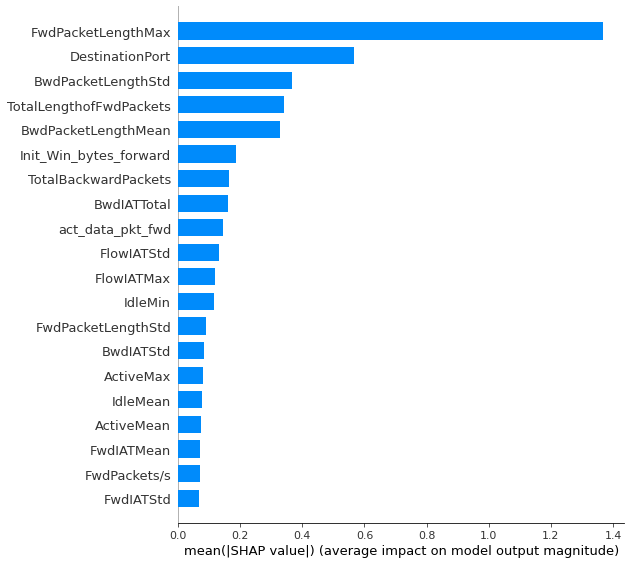

In [20]:
mp.plot(plot_type='bar')

In [21]:
mp.result 

array([[ 1.30648361e-01,  4.14166264e-02,  2.74352942e-03, ...,
        -6.17399942e-02,  7.82985587e-02,  8.06939971e-02],
       [-1.37423881e+00,  7.63216603e-02,  1.03342057e-02, ...,
         8.77862598e-03, -4.85496948e-02, -8.76730880e-02],
       [-1.04303003e+00,  8.40270496e-02,  2.64132395e-02, ...,
         4.82215361e-03, -4.48678066e-02, -8.09908038e-02],
       ...,
       [-6.10743358e-01, -1.03232906e-01,  2.02726465e-02, ...,
        -2.26349083e-02,  6.84345619e-02,  2.23144305e-01],
       [ 8.67305998e-01, -2.87494482e-04, -1.36793734e-02, ...,
         7.85398764e-03,  1.14087988e-01,  4.04461305e-01],
       [ 1.27759977e-01, -9.72609992e-02,  2.60097480e-03, ...,
        -2.47961453e-02, -2.41880663e-02, -6.73296009e-02]])

In [24]:
!pip install -U statsmodels

In [27]:
lime = exp_gbm.predict_surrogate(X.iloc[[1]])
type(lime)

lime.explanation.Explanation

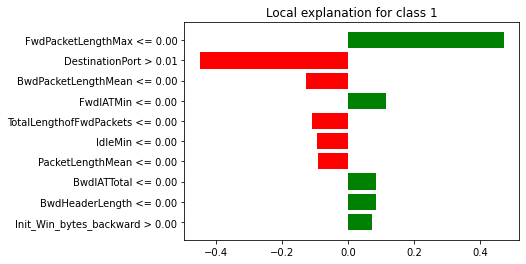

In [28]:
lime.plot()

In [29]:
lime.result

,variable,effect
0,FwdPacketLengthMax <= 0.00,0.471121
1,DestinationPort > 0.01,-0.449695
2,BwdPacketLengthMean <= 0.00,-0.126950
3,FwdIATMin <= 0.00,0.114992
4,TotalLengthofFwdPackets <= 0.00,-0.109757
5,IdleMin <= 0.00,-0.094993
6,PacketLengthMean <= 0.00,-0.090297
7,BwdIATTotal <= 0.00,0.084954
8,BwdHeaderLength <= 0.00,0.084744
9,Init_Win_bytes_backward > 0.00,0.072732


In [30]:
surrogate_model_small = exp_gbm.model_surrogate(type='tree', max_depth=3, max_vars=3)
surrogate_model_small.performance

,recall,precision,f1,accuracy,auc
DecisionTreeClassifier,0.02535,1.0,0.049447,0.02535,0.350496


In [31]:
surrogate_model_big = exp_gbm.model_surrogate(type='tree', max_depth=4, max_vars=4)
surrogate_model_big.performance

,recall,precision,f1,accuracy,auc
DecisionTreeClassifier,0.000707,1.0,0.001412,0.000707,0.346539


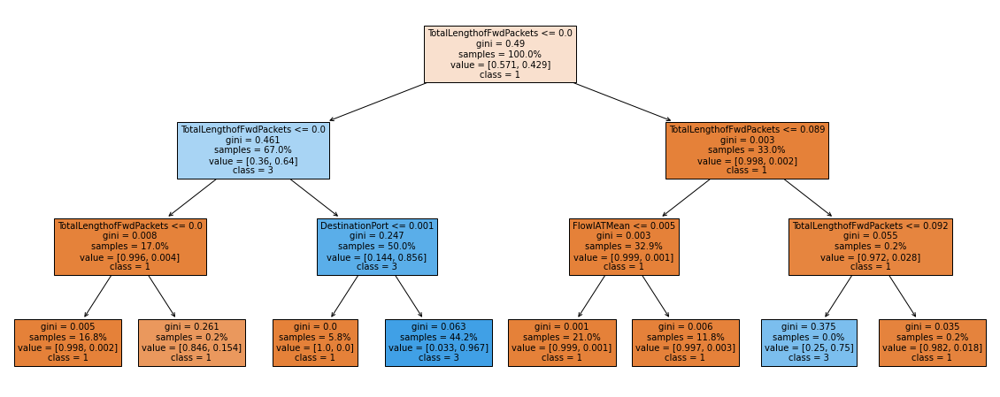

In [32]:
surrogate_model_small.plot(figsize=(20, 8), fontsize=10, filled=True)

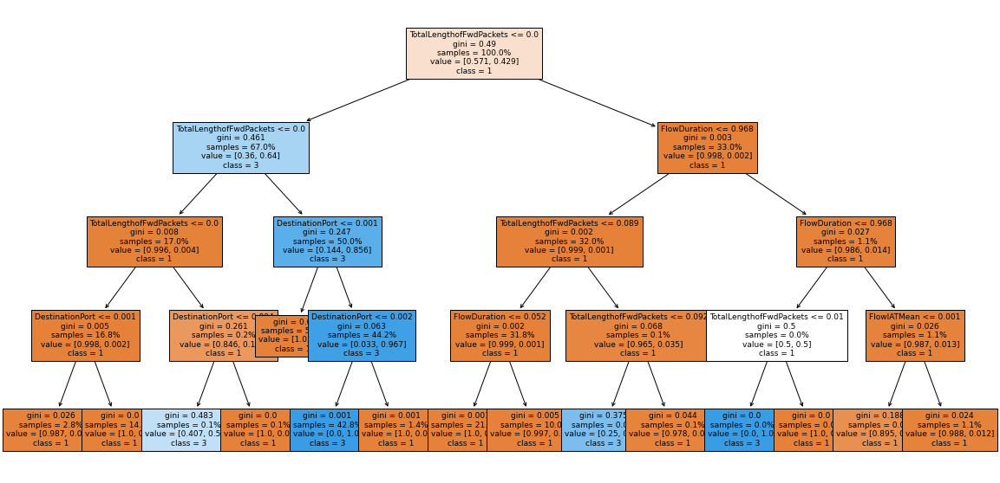

In [33]:
surrogate_model_big.plot(figsize=(20, 10), fontsize=9)

In [34]:
type(surrogate_model_big)

sklearn.tree._classes.DecisionTreeClassifier

In [36]:
pdp1 = exp_gbm.model_profile(variables=['FwdPacketLengthMax', 'DestinationPort', 'BwdPacketLengthStd', 'TotalLengthofFwdPackets'],
                            N=100)

Calculating ceteris paribus: 100%|██████████| 4/4 [00:00<00:00, 12.81it/s]


In [40]:
pdp2 = exp_mlp.model_profile(variables=['FwdPacketLengthMax', 'DestinationPort', 'BwdPacketLengthStd', 'TotalLengthofFwdPackets'],
                            N=100)

Calculating ceteris paribus: 100%|██████████| 4/4 [00:00<00:00, 22.54it/s]


In [41]:
pdp2.plot(geom='profiles')

In [42]:
pdp2

,_vname_,_label_,_x_,_yhat_,_ids_
0,FwdPacketLengthMax,mlp,0.00,1.824775,0
1,FwdPacketLengthMax,mlp,0.01,1.790410,0
2,FwdPacketLengthMax,mlp,0.02,1.756044,0
3,FwdPacketLengthMax,mlp,0.03,1.670130,0
4,FwdPacketLengthMax,mlp,0.04,1.670130,0
...,...,...,...,...,...
399,TotalLengthofFwdPackets,mlp,0.96,1.068731,0
400,TotalLengthofFwdPackets,mlp,0.97,1.068731,0
401,TotalLengthofFwdPackets,mlp,0.98,1.051548,0
402,TotalLengthofFwdPackets,mlp,0.99,1.051548,0
